## Imports

In [4]:
import math
import geopandas
import shapely
import shapefile
import plotly
import numpy as np 
import pandas as pd 
from plotly.figure_factory._county_choropleth import create_choropleth
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
%matplotlib inline

# Quick Data Clean

In [20]:
pd.set_option('display.max_columns', None)

In [21]:
vac = pd.read_csv('../cleaned_data/vac_rate.csv')

hes = pd.read_csv('../cleaned_data/vaccine_hest.csv')

In [4]:
vac.head()

,fips,recip_county,recip_state,series_complete_pop_pct,series_complete_yes,series_complete_12plus,series_complete_12pluspop_pct,series_complete_18plus,series_complete_18pluspop_pct,series_complete_65plus,series_complete_65pluspop_pct,completeness_pct,administered_dose1_recip,administered_dose1_pop_pct,administered_dose1_recip_12plus,administered_dose1_recip_12pluspop_pct,administered_dose1_recip_18plus,administered_dose1_recip_18pluspop_pct,administered_dose1_recip_65plus,administered_dose1_recip_65pluspop_pct,svi_ctgy,series_complete_pop_pct_svi,series_complete_12pluspop_pct_svi,series_complete_18pluspop_pct_svi,series_complete_65pluspop_pct_svi,metro_status,series_complete_pop_pct_ur_equity,series_complete_12pluspop_pct_ur_equity,series_complete_18pluspop_pct_ur_equity,series_complete_65pluspop_pct_ur_equity,administered_dose1_recip_5plus,administered_dose1_recip_5pluspop_pct,series_complete_5plus,series_complete_5pluspop_pct
0,13007,Baker County,GA,35.7,1085,1078.0,40.7,1017,41.6,314,43.7,59.6,1238.0,40.8,1225.0,46.2,1158.0,47.3,346.0,48.1,C,10.0,11.0,11.0,10.0,Metro,2.0,3.0,3.0,2.0,1238.0,43.2,1085.0,37.9
1,6083,Santa Barbara County,CA,65.5,292460,287585.0,75.6,266675,76.6,62612,89.3,97.5,337180.0,75.5,328565.0,86.4,304599.0,87.5,71297.0,95.0,C,12.0,12.0,12.0,12.0,Metro,4.0,4.0,4.0,4.0,337148.0,80.4,292455.0,69.8
2,36051,Livingston County,NY,56.8,35726,35078.0,62.7,32924,63.5,10251,88.9,97.6,38175.0,60.7,37237.0,66.6,34935.0,67.4,10921.0,94.7,B,8.0,8.0,8.0,8.0,Metro,4.0,4.0,4.0,4.0,38174.0,63.4,35726.0,59.3
3,34005,Burlington County,NJ,70.1,312046,305019.0,78.8,285012,80.7,69495,89.8,93.8,361996.0,81.3,350386.0,90.5,327961.0,92.9,80217.0,95.0,A,4.0,4.0,4.0,4.0,Metro,4.0,4.0,4.0,4.0,361967.0,85.6,312041.0,73.8
4,1021,Chilton County,AL,34.0,15086,15032.0,40.1,14277,42.2,4891,64.4,92.7,18410.0,41.4,18254.0,48.7,17335.0,51.2,5658.0,74.4,D,14.0,15.0,15.0,15.0,Metro,2.0,3.0,3.0,3.0,18409.0,44.1,15086.0,36.2


In [5]:
hes.head()

,fips_code,state,estimated_hesitant,estimated_hesitant_or_unsure,estimated_strongly_hesitant,social_vulnerability_index_(svi),svi_category,cvac_level_of_concern_for_vaccination_rollout,cvac_level_of_concern,percent_adults_fully_vaccinated_against_covid-19_(as_of_6/10/21),percent_hispanic,percent_non-hispanic_american_indian/alaska_native,percent_non-hispanic_asian,percent_non-hispanic_black,percent_non-hispanic_native_hawaiian/pacific_islander,percent_non-hispanic_white,state_code,name_of_county
0,1123,ALABAMA,0.1806,0.2400,0.1383,0.89,Very High Vulnerability,0.64,High Concern,0.305,0.0242,0.0022,0.0036,0.2697,0.0000,0.6887,AL,Tallapoosa County
1,1121,ALABAMA,0.1783,0.2350,0.1368,0.87,Very High Vulnerability,0.84,Very High Concern,0.265,0.0229,0.0043,0.0061,0.3237,0.0003,0.6263,AL,Talladega County
2,1131,ALABAMA,0.1735,0.2357,0.1337,0.93,Very High Vulnerability,0.94,Very High Concern,0.394,0.0053,0.0009,0.0003,0.6938,0.0000,0.2684,AL,Wilcox County
3,1129,ALABAMA,0.1735,0.2357,0.1337,0.73,High Vulnerability,0.82,Very High Concern,0.308,0.0146,0.0731,0.0025,0.2354,0.0000,0.6495,AL,Washington County
4,1133,ALABAMA,0.1805,0.2313,0.1379,0.70,High Vulnerability,0.80,High Concern,0.163,0.0315,0.0034,0.0016,0.0073,0.0005,0.9370,AL,Winston County


In [88]:
hes['estimated_hesitant'] = hes['estimated_hesitant'] * 100
hes['social_vulnerability_index_(svi)'] = hes['social_vulnerability_index_(svi)'] * 100
hes['cvac_level_of_concern_for_vaccination_rollout'] = hes['cvac_level_of_concern_for_vaccination_rollout'] * 100

Some percentages are described as decimals. Standardizing format for better readability

# County Choropleth Maps

County maps were made following plotly's choropleth guide: https://plotly.com/python/county-choropleth/

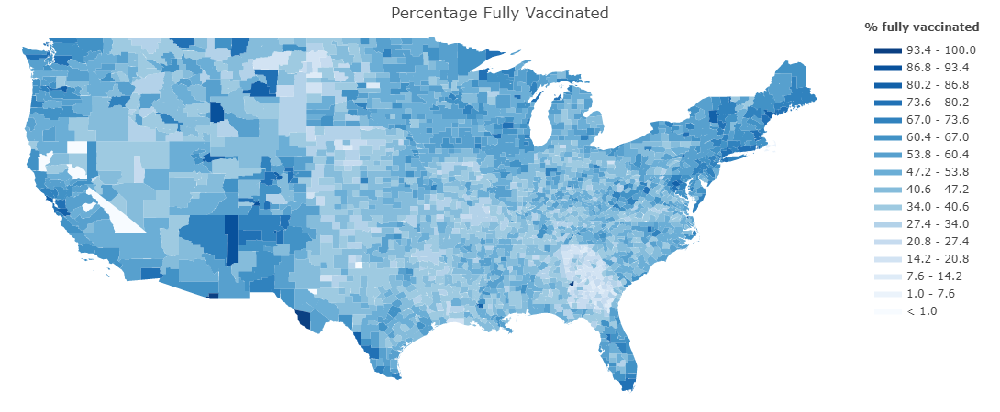

In [165]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 100, len(colorscale) - 1))
fips = vac['fips'].tolist()
values = vac['series_complete_pop_pct'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='Percentage Fully Vaccinated',
    legend_title='% fully vaccinated'
)

fig.layout.template = None
fig.show()

![](../images/vaccinated.png)

Most counties showing up. Vaccine percentage per county about what I expected, with Georgia clearly behind other states.

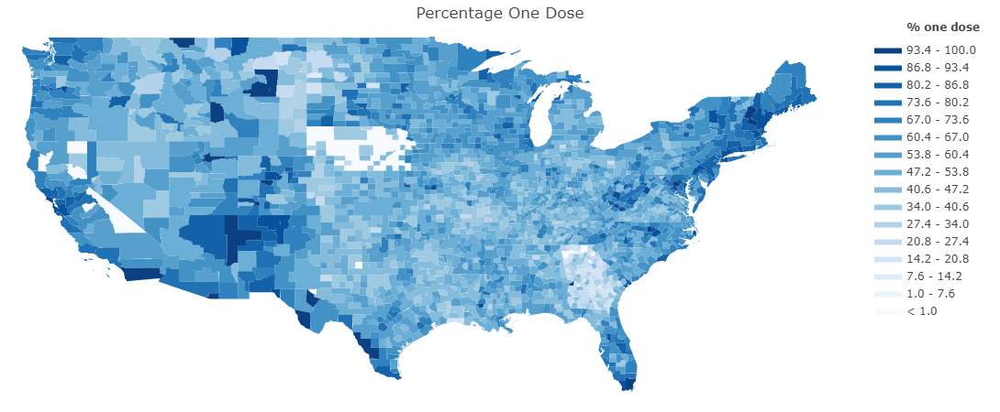

In [90]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 100, len(colorscale) - 1))
fips = vac['fips'].tolist()
values = vac['administered_dose1_pop_pct'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='Percentage One Dose',
    legend_title='% one dose'
)

fig.layout.template = None
fig.show()

![](../images/vacc_one_dose.png)

A few more counties not recording who only has received one dose, mostly in rural Nebraska. Data maps well onto total vaccinated numbers, with no weird outliers way ahead on the first dose, but lagging on the second dose.

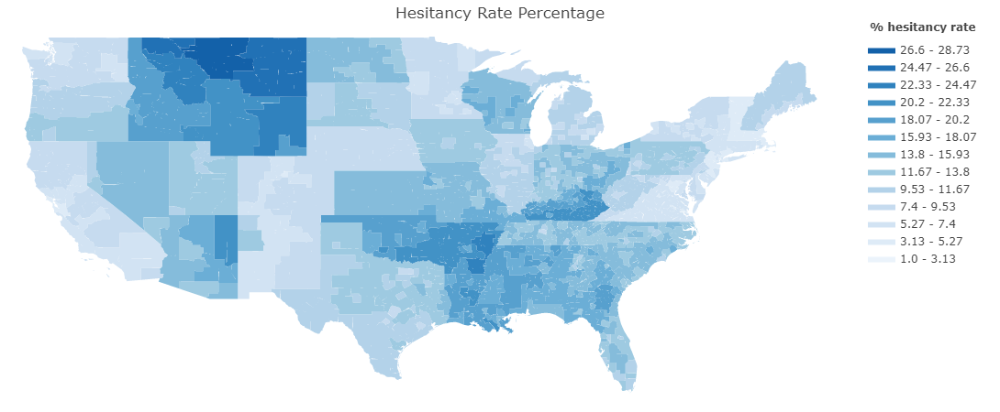

In [95]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 33, len(colorscale) - 1))
fips = hes['fips_code'].tolist()
values = hes['estimated_hesitant'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='Hesitancy Rate Percentage',
    legend_title='% hesitancy rate '
)

fig.layout.template = None
fig.show()

![](../images/hesitancy.png)

Interestingly, the only map with clear state lines across the whole map. This fact means that either: vaccine hesitancy is heavily informed by state culture rather than county, or states are using different metrics to determine vaccine hesitancy. Or a mix of both. Vaccine hestiancy higher in southern states and the northern Rockies.

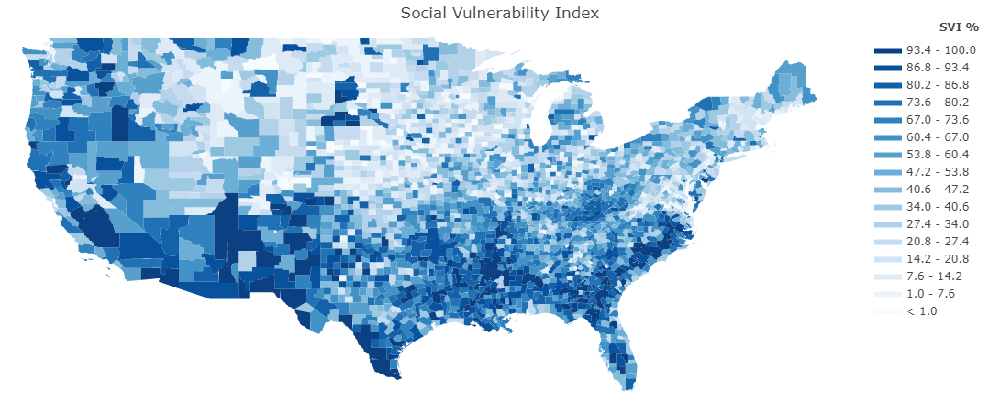

In [96]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 100, len(colorscale) - 1))
fips = hes['fips_code'].tolist()
values = hes['social_vulnerability_index_(svi)'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='Social Vulnerability Index',
    legend_title='SVI %'
)

fig.layout.template = None
fig.show()

![](../images/svi.png)

Looking at how badly counties might be affected by a COVID outbreak. Mostly the southern states as well as California and the Pacific Northwest.

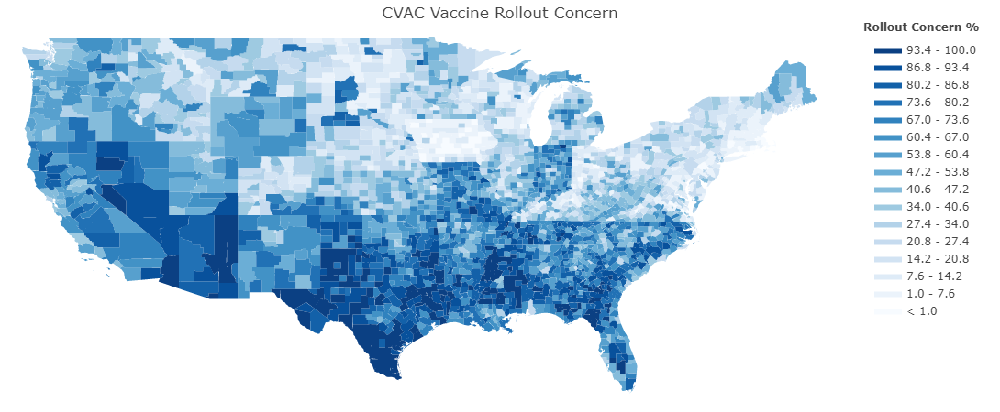

In [97]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 100, len(colorscale) - 1))
fips = hes['fips_code'].tolist()
values = hes['cvac_level_of_concern_for_vaccination_rollout'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='CVAC Vaccine Rollout Concern',
    legend_title='Rollout Concern %'
)

fig.layout.template = None
fig.show()

![](../images/vaccine_rollout_concern.png)

Looking at how worried the CVAC is worried about the ability to distribute vaccines across counties. Maps fairly closely to SVI index, with exceptions of more rollout concern for Missouri and Indiana, and less concern about Kentucky.

# Looking at Most/Least Vaccinated Counties against Features

In [24]:
merg = pd.read_csv('../cleaned_data/merged.csv')
merg['estimated_hesitant'] = merg['estimated_hesitant'] * 100 #keeping percentages consistent

### Most Hesitant Counties vs Vaccination Rate

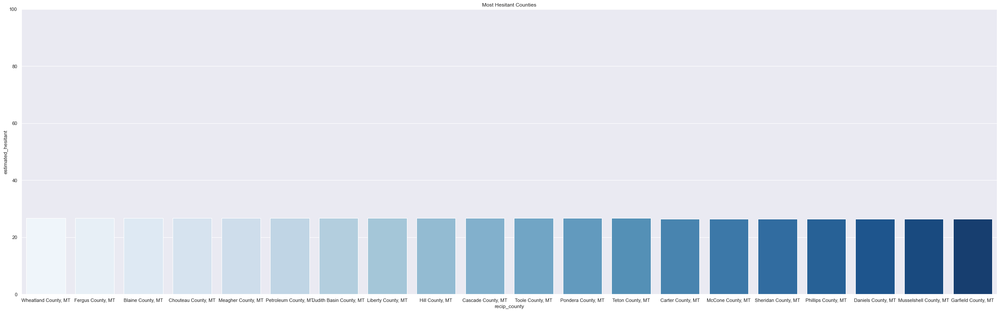

In [25]:
hes_most = merg.sort_values(by='estimated_hesitant', ascending=False).head(20)
#keeping the number smaller to stay presentable on a computer presentation
hes_most['recip_county'] = hes_most['recip_county'] + ', ' + hes_most['recip_state'] 
#there counties with the same name in different states that also happen to be on the same most/least graphs, interestingly enough

plt.figure(figsize = (40,12))

ax = sns.barplot(x = "recip_county", 
                 y = "estimated_hesitant",
                 palette = 'Blues',
                data = hes_most).set(title = 'Most Hesitant Counties', ylim=(0, 100))

plt.savefig('../images/mh')

All Montana counties showing up as they are the least dense state, and people might not feel the vaccine is necessary as they are having little contact with others.

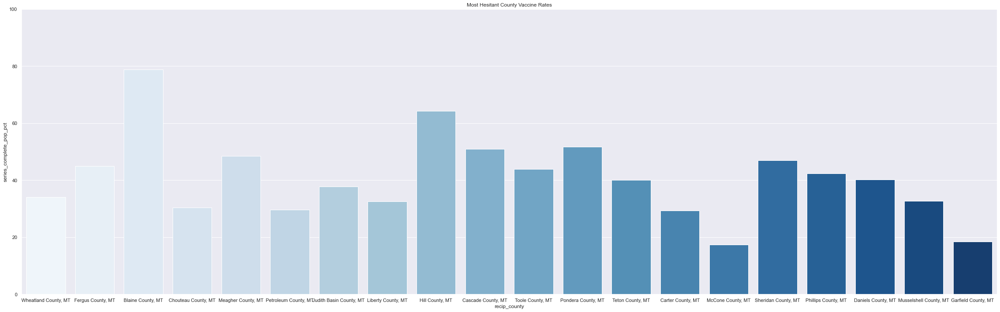

In [33]:
plt.figure(figsize = (40,12))

ax = sns.barplot(x = "recip_county", 
                 y = "series_complete_pop_pct",
                 palette = 'Blues',
                data = hes_most).set(title = 'Most Hesitant County Vaccine Rates', ylim=(0, 100))

plt.savefig('../images/mh_vacc')

Despite similar hesitancy rates, massive variance in vaccination rates.

### Least Hesitant Counties vs Vaccination Rate

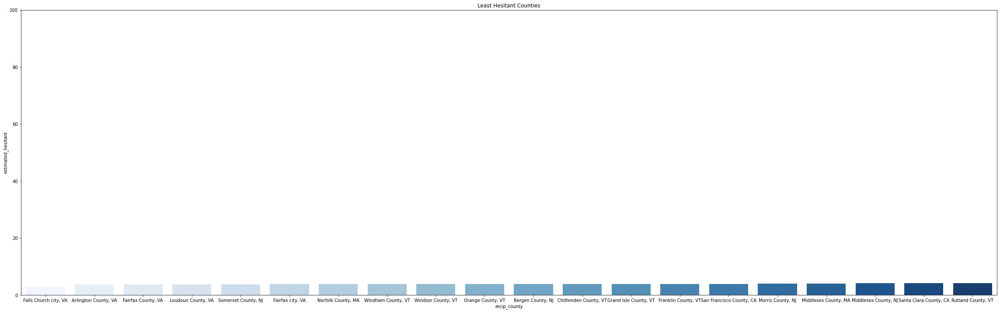

In [160]:
hes_least = merg.sort_values(by='estimated_hesitant', ascending=True).head(20)
hes_least['recip_county'] = hes_least['recip_county'] + ', ' + hes_least['recip_state']

plt.figure(figsize = (40,12))

ax = sns.barplot(x = "recip_county", 
                 y = "estimated_hesitant",
                 palette = 'Blues',
                data = hes_least).set(title = 'Least Hesitant Counties', ylim=(0, 100))

plt.savefig('../images/lh')

Around a 3% hesitancy rate for the lowest. Counties found mostly in the Northeast and California.

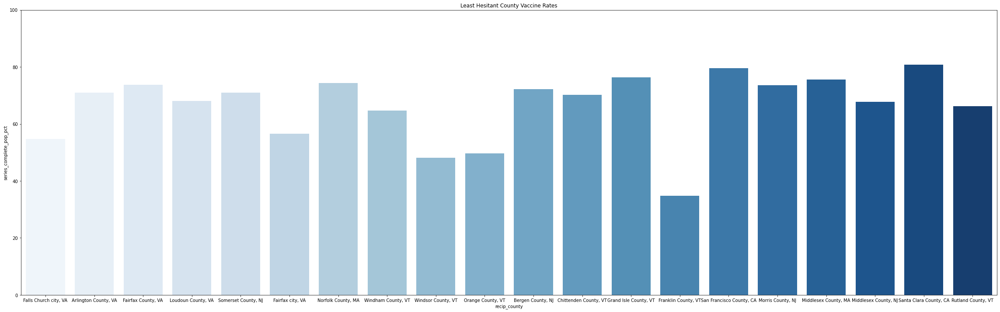

In [161]:
plt.figure(figsize = (40,12))

ax = sns.barplot(x = "recip_county", 
                 y = "series_complete_pop_pct",
                 palette = 'Blues',
                data = hes_least).set(title = 'Least Hesitant County Vaccine Rates', ylim=(0, 100))

plt.savefig('../images/lh_vacc')

More consistently higher vaccination rates as compared to the most hesitant counties. However, still a good deal of variance.

### Most and Least Vaccinated Counties

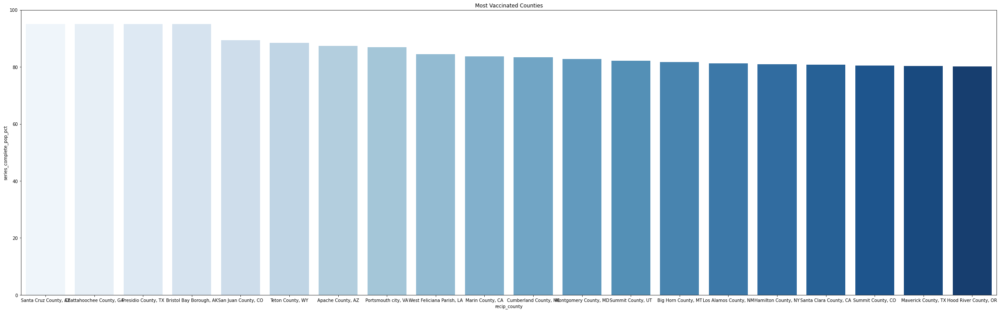

In [162]:
vac_most = merg.sort_values(by='series_complete_pop_pct', ascending=False).head(20)
vac_most['recip_county'] = vac_most['recip_county'] + ', ' + vac_most['recip_state']

plt.figure(figsize = (40,12))

ax = sns.barplot(x = "recip_county", 
                 y = "series_complete_pop_pct",
                 palette = 'Blues',
                data = vac_most).set(title = 'Most Vaccinated Counties', ylim=(0, 100))

plt.savefig('../images/most_vacc')

No real pattern for most vaccinated counties. Counties coming from the whole of the US.

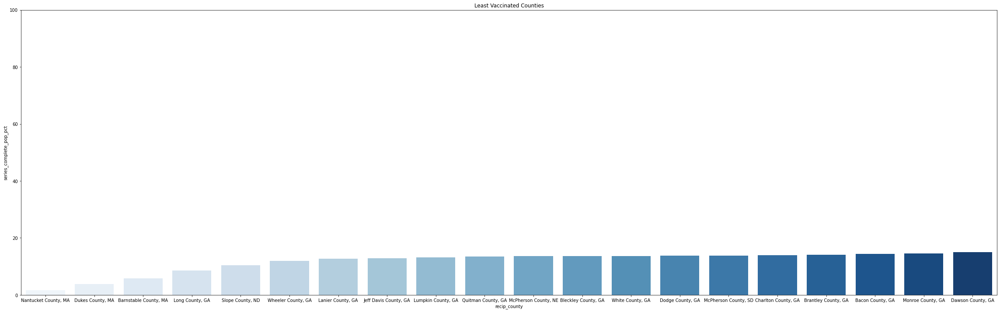

In [163]:
vac0 = merg[merg['series_complete_pop_pct'] > 0]
vac_least = vac0.sort_values(by='series_complete_pop_pct', ascending=True).head(20)
vac_least['recip_county'] = vac_least['recip_county'] + ', ' + vac_least['recip_state']

plt.figure(figsize = (40,12))

ax = sns.barplot(x = "recip_county", 
                 y = "series_complete_pop_pct",
                 palette = 'Blues',
                data = vac_least).set(title = 'Least Vaccinated Counties', ylim=(0, 100))

plt.savefig('../images/least_vacc')

To no surprise from earlier visualization, Georgian counties among the most on the chart, with surprisingly some Massachusettes counties.

# Vaccine Distribution over Time from State Sampling

Although our model will not be factoring time, I still want to take a glance of distribution to see if there are any useful patterns to inform ourselves.

In [8]:
alloc = pd.read_csv('../datasets/state_allocation.csv')
alloc = alloc[['Date', 'Location', 'Distributed']] #the only relevant columns for our graph
alloc['Date']=pd.to_datetime(alloc['Date']).dt.normalize() #better date format for sorting

states = ['FL', 'TX','GA', 'CA', 'NY', 'LA', 'CO', 'AZ', 'MT','IL']
#graphing all states looks messy. taking a few states to give us a general idea.

alloc = alloc.join(pd.DataFrame(
    {state: state for state in states}, index=alloc.index))
#the chart has all the data for a line graph, but is in a complicated format.transforming the graph so that the rows will be unique dates and the 
#columns will be the sampled states

for state in states:
    state_col = alloc[alloc.Location.str.contains(state)] #grabbing the rows the only pertain to the specific state
    state_dict = dict(zip(state_col.Date, state_col.Distributed)) #creating a dictionary of date and where the state's distribution was
    alloc[state] = alloc['Date'].map(state_dict) #placing the dictionary values in the corresponding row of our newly made columns
    
alloc = alloc.drop_duplicates(['Date']) #removing duplicate information

alloc.fillna(method='bfill') #some dates missing information. grabbing the distribution from the most previous date.

alloc = alloc.fillna(0) #some states start with no distribution data. making number 0 for readability.

alloc.set_index('Date', inplace = True) #removing date column, making it the index for easier line graph programming.

alloc.drop(columns=['Location', 'Distributed'], inplace = True) #removing last column that won't show up on line graph

In [13]:
alloc

,FL,TX,GA,CA,NY,LA,CO,AZ,MT,IL
Date,,,,,,,,,,
2022-01-05,40827295.0,52079695.0,18382505.0,76439625.0,39444725.0,6892830.0,10884185.0,12623930.0,1733335.0,23424565.0
2022-01-04,40557635.0,51841585.0,18270005.0,76094855.0,38995275.0,6871910.0,10837215.0,12582250.0,1726035.0,23217835.0
2022-01-03,40557435.0,51841445.0,18270005.0,76094855.0,38995375.0,6871910.0,10837215.0,12582250.0,1726035.0,23217835.0
2022-01-02,40585315.0,51849705.0,18299045.0,76115635.0,38996915.0,6871910.0,10838535.0,12582850.0,1726035.0,23218875.0
2022-01-01,40598455.0,51865205.0,18305485.0,76159815.0,39023815.0,6872750.0,10844695.0,12585270.0,1726595.0,23221235.0
...,...,...,...,...,...,...,...,...,...,...
2020-12-17,185250.0,224250.0,74100.0,326625.0,151125.0,39000.0,46800.0,58500.0,9750.0,109200.0
2020-12-16,118950.0,94575.0,22425.0,195000.0,90675.0,39000.0,46800.0,58500.0,9750.0,47775.0
2020-12-15,118950.0,94575.0,5850.0,148200.0,87750.0,35100.0,34125.0,58500.0,9750.0,47775.0


Numbers all slowly tick upwards. A good sign.

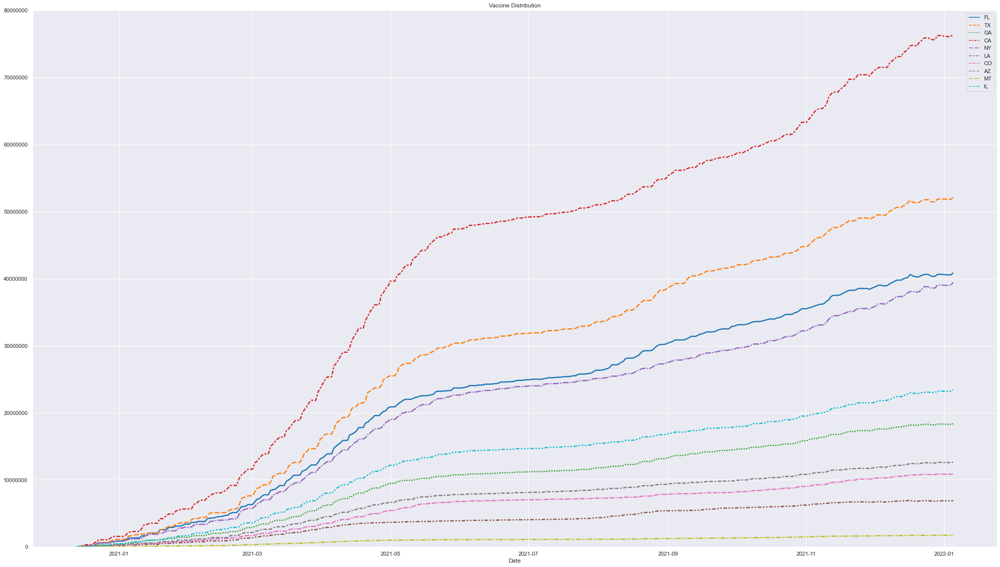

In [9]:
sns.set_theme(style="darkgrid")

plt.figure(figsize = (35,20))

sns.lineplot(data=alloc, palette="tab10", linewidth=2.5).set(title = 'Vaccine Distribution', ylim=(0, 80000000));

plt.ticklabel_format(style='plain', axis='y')

plt.savefig('../images/state_distr')

All states follow same curve over time. Florida and New York have almost identical population and have almost the same plot. When scaling population numbers for states, all follow almost the identical line. It is safe to say that state distribution is determined almost solely by population. Hopefully our model can distribute vaccines in a more efficient manner as not all states will use their allocated vaccines and will go to waste.